In [1]:
import os
import numpy as np
import pandas as pd
from IPython.display import Audio, display

In [2]:
import torch
import torchaudio
import torchaudio.functional as F
import torchaudio.transforms as T

print(torch.__version__)
print(torchaudio.__version__)

torchaudio.set_audio_backend("soundfile")

1.8.1
0.8.1


C:\Users\kim\Anaconda3\lib\site-packages\torchaudio\extension\extension.py:13: UserWarning: torchaudio C++ extension is not available.
  warnings.warn('torchaudio C++ extension is not available.')


In [3]:
SAMPLE_DIR = '../data/audio/'
SAMPLE_FILE = 'GameMusic.wav'
SAMPLE_WAV_PATH = os.path.join(SAMPLE_DIR, SAMPLE_FILE)

metadata = torchaudio.info(SAMPLE_WAV_PATH)
print(metadata)

#Audio(SAMPLE_WAV_PATH, autoplay=True)

In [4]:
def print_stats(waveform, sample_rate=None, src=None):
    if src:
        print("-" * 10)
        print("Source:", src)
        print("-" * 10)
    if sample_rate:
        print("Sample Rate:", sample_rate)
    print("Shape:", tuple(waveform.shape))
    print("Dtype:", waveform.dtype)
    print(f" - Max:     {waveform.max().item():6.3f}")
    print(f" - Min:     {waveform.min().item():6.3f}")
    print(f" - Mean:    {waveform.mean().item():6.3f}")
    print(f" - Std Dev: {waveform.std().item():6.3f}")
    print()
    print(waveform)
    print()


def plot_waveform(waveform, sample_rate, title="Waveform", xlim=None, ylim=None):
    waveform = waveform.numpy()

    num_channels, num_frames = waveform.shape
    time_axis = torch.arange(0, num_frames) / sample_rate

    figure, axes = plt.subplots(num_channels, 1)
    if num_channels == 1:
        axes = [axes]
    for c in range(num_channels):
        axes[c].plot(time_axis, waveform[c], linewidth=1)
        axes[c].grid(True)
        if num_channels > 1:
            axes[c].set_ylabel(f"Channel {c+1}")
        if xlim:
            axes[c].set_xlim(xlim)
        if ylim:
            axes[c].set_ylim(ylim)
    figure.suptitle(title)
    plt.show(block=False)


def plot_specgram(waveform, sample_rate, title="Spectrogram", xlim=None):
    waveform = waveform.numpy()

    num_channels, num_frames = waveform.shape

    figure, axes = plt.subplots(num_channels, 1)
    if num_channels == 1:
        axes = [axes]
    for c in range(num_channels):
        axes[c].specgram(waveform[c], Fs=sample_rate)
        if num_channels > 1:
            axes[c].set_ylabel(f"Channel {c+1}")
        if xlim:
            axes[c].set_xlim(xlim)
    figure.suptitle(title)
    plt.show(block=False)


def play_audio(waveform, sample_rate):
    waveform = waveform.numpy()

    num_channels, num_frames = waveform.shape
    if num_channels == 1:
        display(Audio(waveform[0], rate=sample_rate))
    elif num_channels == 2:
        display(Audio((waveform[0], waveform[1]), rate=sample_rate))
    else:
        raise ValueError("Waveform with more than 2 channels are not supported.")

def inspect_file(path):
    print("-" * 10)
    print("Source:", path)
    print("-" * 10)
    print(f" - File size: {os.path.getsize(path)} bytes")
    print(f" - {torchaudio.info(path)}")


Sample Rate: 44100
Shape: (2, 7130274)
Dtype: torch.float32
 - Max:      1.000
 - Min:     -1.000
 - Mean:     0.000
 - Std Dev:  0.210

tensor([[ 0.0000,  0.0083,  0.0157,  ...,  0.0562,  0.0616,  0.0557],
        [-0.0001,  0.0090,  0.0158,  ..., -0.0059, -0.0049, -0.0034]])



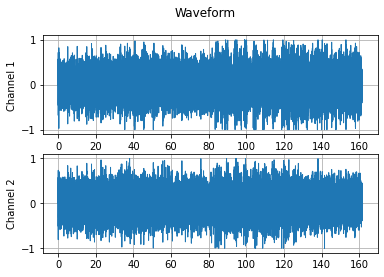

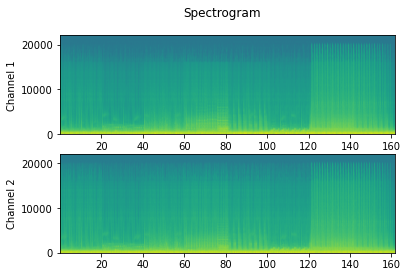

In [23]:
torchaudio.backend.soundfile_backend.load(SAMPLE_WAV_PATH)

waveform, sample_rate = torchaudio.load(SAMPLE_WAV_PATH)

print_stats(waveform, sample_rate=sample_rate)
plot_waveform(waveform, sample_rate)
plot_specgram(waveform, sample_rate)
play_audio(waveform, sample_rate)

In [27]:
path = '../data/audio/save_example_default.wav'
torchaudio.save(path, waveform, sample_rate)
inspect_file(path)

----------
Source: ../data/audio/save_example_default.wav
----------
 - File size: 57042280 bytes
 - <torchaudio.backend.common.AudioMetaData object at 0x0000026129513400>


In [28]:
import io
import os
import math
import tarfile
import multiprocessing

import scipy
#import librosa
import boto3
from botocore import UNSIGNED
from botocore.config import Config
import requests
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import time
from IPython.display import Audio, display

_SAMPLE_DIR = "../data/"
SAMPLE_WAV_URL = "https://pytorch-tutorial-assets.s3.amazonaws.com/steam-train-whistle-daniel_simon.wav"
SAMPLE_WAV_PATH = os.path.join(_SAMPLE_DIR, "GameMusic.wav")

## filename = "./data/SpeechCommands/speech_commands_v0.02/yes/00f0204f_nohash_0.wav"
filename = "../data/audio/GameMusic.wav"
waveform, sample_rate = torchaudio.load(filepath=filename, num_frames=3)
print(f'waveform tensor:{waveform}')
#waveform, sample_rate = torchaudio.load(filepath=filename, num_frames=3, offset =2)
#print(waveform)
waveform, sample_rate = torchaudio.load(filepath=filename)
print(waveform)

waveform tensor:tensor([[ 0.0000,  0.0083,  0.0157],
        [-0.0001,  0.0090,  0.0158]])
tensor([[ 0.0000,  0.0083,  0.0157,  ...,  0.0562,  0.0616,  0.0557],
        [-0.0001,  0.0090,  0.0158,  ..., -0.0059, -0.0049, -0.0034]])


https://docs.microsoft.com/fi-fi/learn/modules/intro-audio-classification-pytorch/3-visualizations-transforms
    
https://pytorch.org/audio/master/tutorials/audio_io_tutorial.html